<a href="https://colab.research.google.com/github/arumajirou/-daily-test/blob/main/DifFace_ipynb.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## **DifFace:拡散誤差収縮を用いた盲目顔面修復法**

[Zongsheng Yue](https://zsyoaoa.github.io/) and [Chen Change Loy](https://www.mmlab-ntu.com/person/ccloy/)

[![arXiv](https://img.shields.io/badge/arXiv-Paper-<COLOR>.svg)](https://arxiv.org/abs/2212.06512) [![GitHub Stars](https://img.shields.io/github/stars/zsyOAOA/DifFace?affiliations=OWNER&color=green&style=social)](https://github.com/zsyOAOA/DifFace) [![Hugging Face](https://img.shields.io/badge/Demo-Hugging%20Face-blue)](https://huggingface.co/spaces/OAOA/DifFace) ![visitors](https://visitor-badge.laobi.icu/badge?page_id=zsyOAOA/DifFace) 

# **Conda環境のセットアップ**
開始する前に、選択されていることを確認してください。
- Hardware Accelerator = GPU (ランタイムメニュー -> ランタイムタイプの変更)

In [2]:
# Miniconda3のインストール
# https://github.com/conda-incubator/condacolab
!pip install -q condacolab
import condacolab
condacolab.install_miniconda()

⏬ Downloading https://repo.anaconda.com/miniconda/Miniconda3-py38_4.12.0-Linux-x86_64.sh...
📦 Installing...
📌 Adjusting configuration...
🩹 Patching environment...
⏲ Done in 0:00:17
🔁 Restarting kernel...


In [3]:
import os
os.chdir("/content")
CODE_DIR = "DifFace"
print("Done...")

Done...


## **クローンレポジトリー**

In [4]:
# クローンレポジトリー
import shutil
from pathlib import Path
if Path(CODE_DIR).exists():
  shutil.rmtree(CODE_DIR)

!git clone https://github.com/zsyOAOA/DifFace.git $CODE_DIR
os.chdir(f"./{CODE_DIR}")
print("Done...")

Cloning into 'DifFace'...
remote: Enumerating objects: 372, done.
remote: Counting objects: 100% (372/372), done.
remote: Compressing objects: 100% (307/307), done.
remote: Total 372 (delta 76), reused 354 (delta 61), pack-reused 0
Receiving objects: 100% (372/372), 15.72 MiB | 4.18 MiB/s, done.
Resolving deltas: 100% (76/76), done.
Done...


In [5]:
"""
アナコンダ環境の管理:
https://docs.conda.io/projects/conda/en/4.6.0/user-guide/tasks/manage-environments.html
"""
# 自分の環境の一覧を表示する
!conda info --envs
# 環境の更新
!conda env update -n base -f /content/DifFace/environment.yaml
print("Done...")

# conda environments:
#
base                  *  /usr/local

Solving environment: / - \ | / - \ | / - \ | / - \ | / WARNING conda.core.solve:_add_specs(648): pinned spec cudatoolkit=11.2 conflicts with explicit specs.  Overriding pinned spec.
- \ | / - \ done


==> WARNING: A newer version of conda exists. <==
  current version: 4.12.0
  latest version: 22.11.1

Please update conda by running

    $ conda update -n base -c defaults conda



setuptools-65.5.0    | 1.1 MB    | : 100% 1.0/1 [00:00<00:00,  6.23it/s]
ca-certificates-2022 | 124 KB    | : 100% 1.0/1 [00:00<00:00, 17.54it/s]
readline-8.2         | 357 KB    | : 100% 1.0/1 [00:00<00:00, 15.39it/s]
ncurses-6.3          | 781 KB    | : 100% 1.0/1 [00:00<00:00,  4.35it/s]
_openmp_mutex-5.1    | 21 KB     | : 100% 1.0/1 [00:00<00:00, 17.49it/s]
xz-5.2.6             | 394 KB    | : 100% 1.0/1 [00:00<00:00, 15.23it/s]
tk-8.6.12            | 3.0 MB    | : 100% 1.0/1 [00:00<00:00,  6.99it/s

In [6]:
# 自分の環境の一覧を表示する
!conda info --envs

# conda environments:
#
base                  *  /usr/local



## **推論**

In [7]:
# 可視化機能
import cv2
import matplotlib.pyplot as plt
def display(img1, img2):
  fig = plt.figure(figsize=(25, 10))
  ax1 = fig.add_subplot(1, 2, 1) 
  plt.title('Input', fontsize=16)
  ax1.axis('off')
  ax2 = fig.add_subplot(1, 2, 2)
  plt.title('DifFace', fontsize=16)
  ax2.axis('off')
  ax1.imshow(img1)
  ax2.imshow(img2)
def imread(img_path):
  img = cv2.imread(img_path)
  if img.ndim > 3:
    img = img[:, :, :3]
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  return img

Downloading: "https://github.com/zsyOAOA/DifFace/releases/download/V1.0/iddpm_ffhq512_ema500000.pth" to /content/DifFace/weights/diffusion/iddpm_ffhq512_ema500000.pth

100% 610M/610M [00:20<00:00, 31.1MB/s]
Downloading: "https://github.com/zsyOAOA/DifFace/releases/download/V1.0/General_Face_ffhq512.pth" to /content/DifFace/weights/SwinIR/General_Face_ffhq512.pth

100% 86.0M/86.0M [00:04<00:00, 20.5MB/s]
Setting random seed 20000
Loading from ./weights/diffusion/iddpm_ffhq512_ema500000.pth...
Loaded Done
/usr/local/lib/python3.8/site-packages/torch/functional.py:478: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  ../aten/src/ATen/native/TensorShape.cpp:2895.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
Loading from ./weights/SwinIR/General_Face_ffhq512.pth...
Loaded Done
Processing: 5/20...
Processing: 10/20...
Processing: 15/20...
Processing: 20/20...


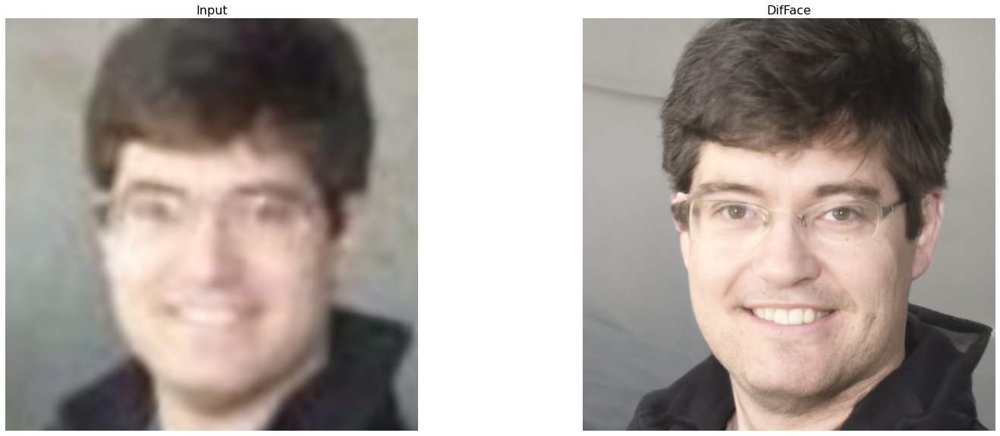

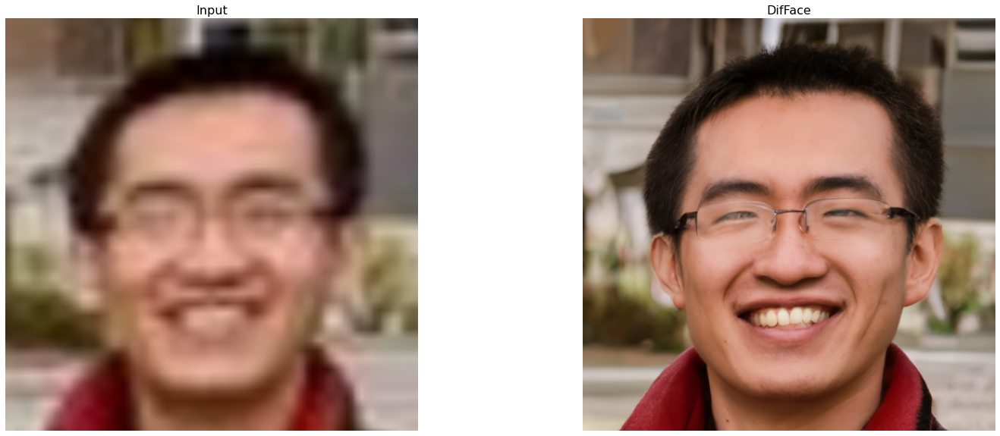

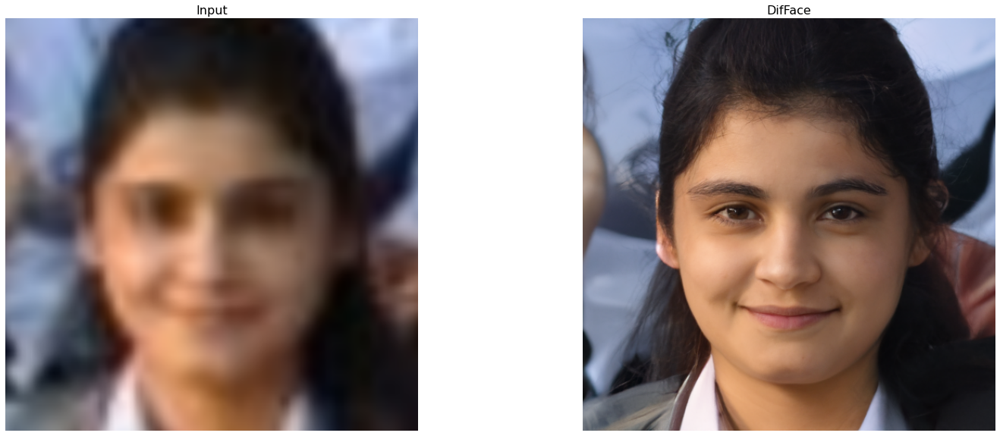

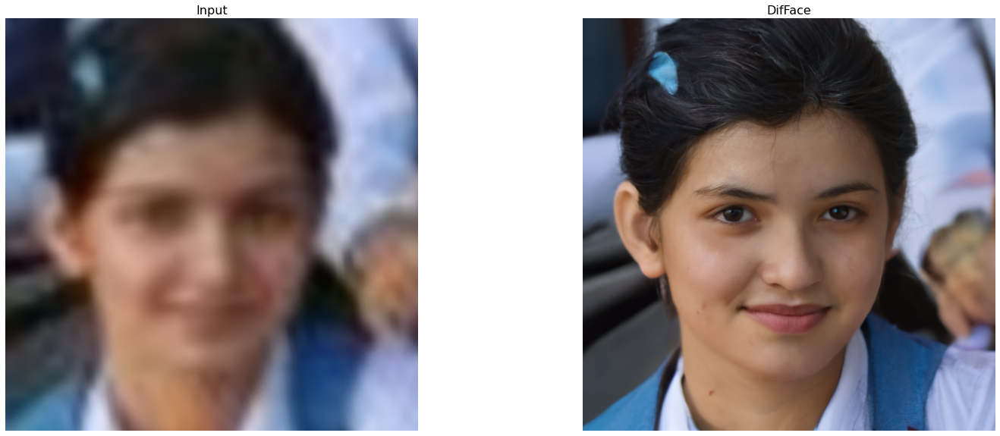

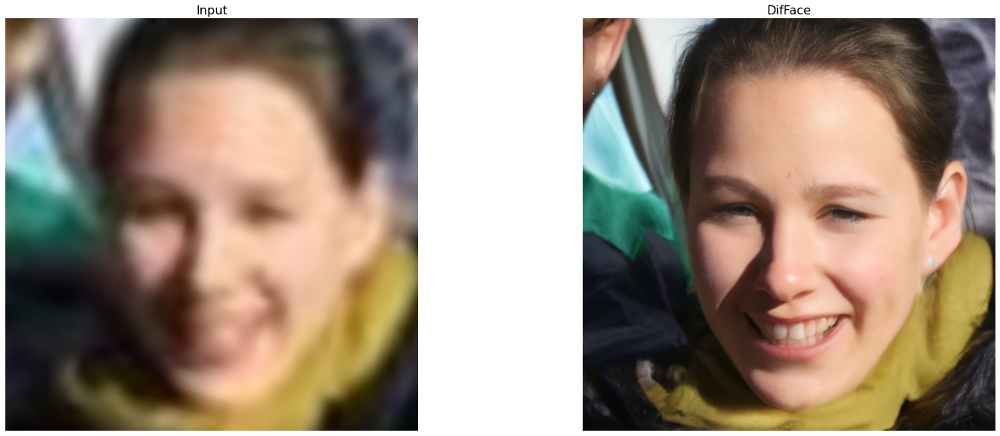

...

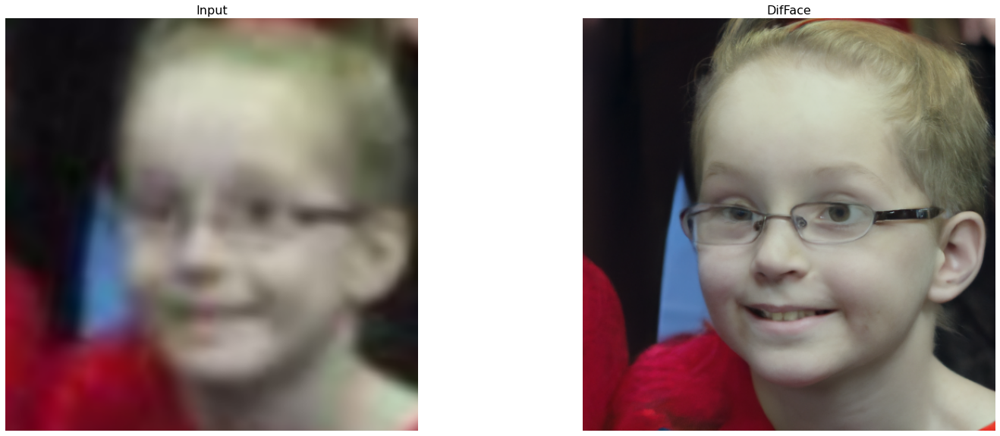

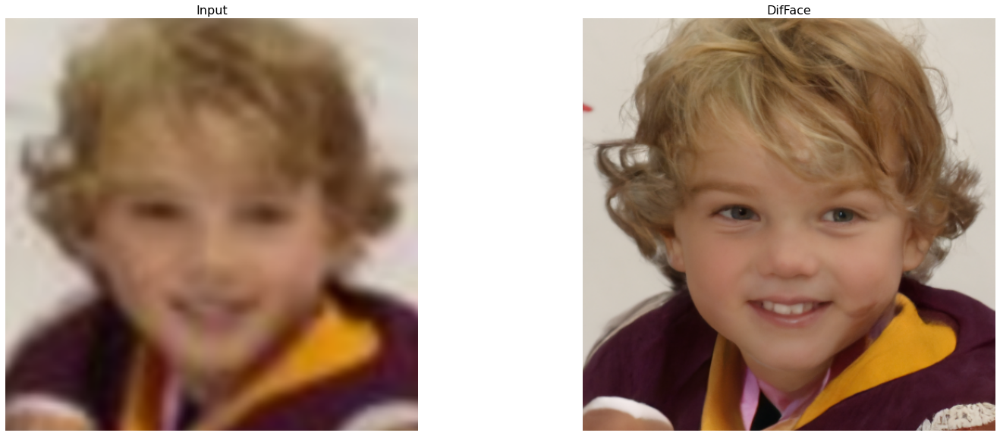

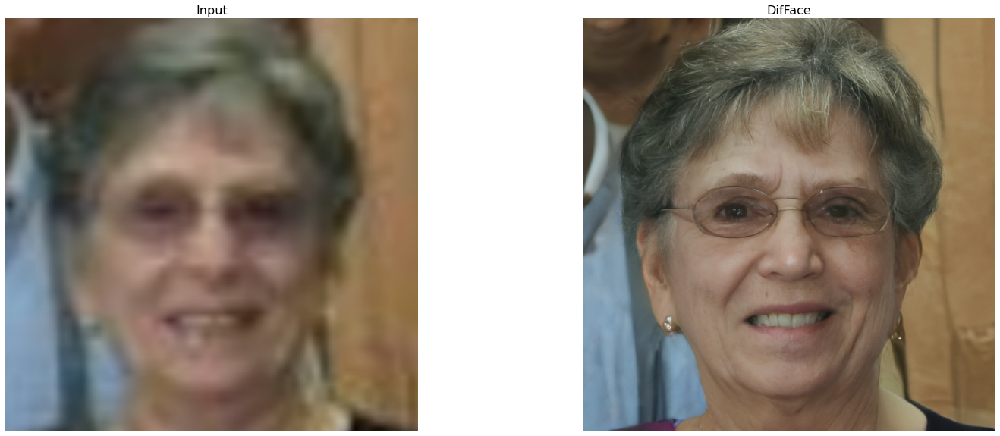

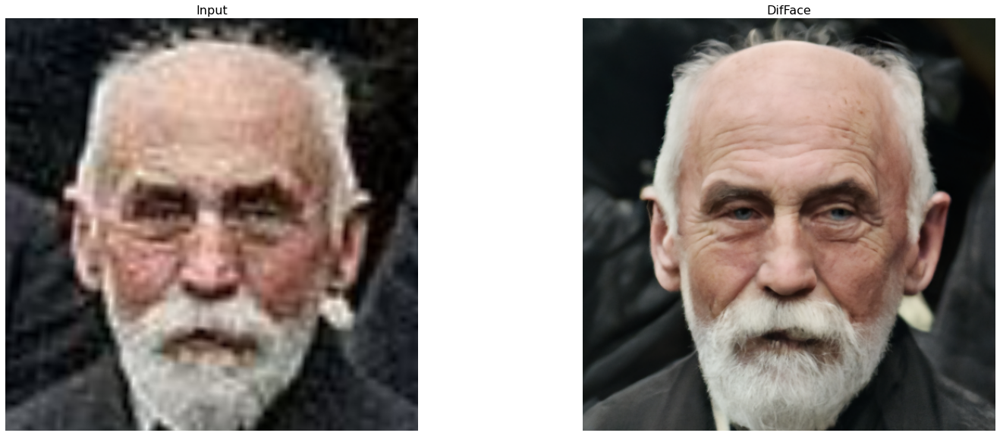

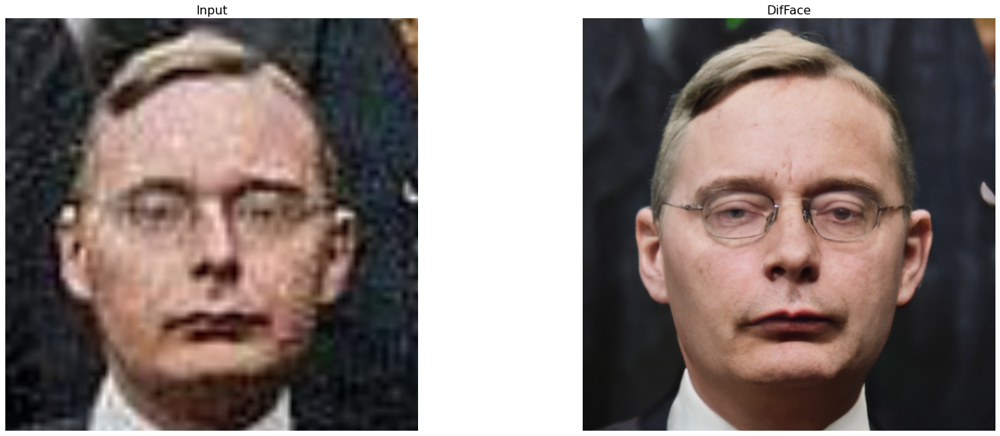

In [8]:
#  顔画像の復元（切り出し、位置合わせ）
"""
!python inference_difface.py 
  --整列
  --入力パス [image folder/image path] 
  --出力パス [result folder] 
  --gpu_id [gpu index]
"""

!python /content/DifFace/inference_difface.py \
  --aligned \
  --in_path /content/DifFace/testdata/cropped_faces \
  --out_path /content/result_aligned \
  --gpu_id 0

im_path_list = sorted([x for x in Path("/content/DifFace/testdata/cropped_faces").glob("*.png")])
out_dir = Path("/content/result_aligned/restored_faces")
for im_path_in in im_path_list:
  im1 = imread(str(im_path_in))
  im_path_out = out_dir / im_path_in.name
  im2 = imread(str(im_path_out))
  display(im1, im2)

Setting random seed 20000
Loading from ./weights/diffusion/iddpm_ffhq512_ema500000.pth...
Loaded Done
/usr/local/lib/python3.8/site-packages/torch/functional.py:478: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  ../aten/src/ATen/native/TensorShape.cpp:2895.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
Loading from ./weights/SwinIR/General_Face_ffhq512.pth...
Loaded Done
Downloading: "https://github.com/sczhou/CodeFormer/releases/download/v0.1.0/yolov5l-face.pth" to /content/DifFace/weights/facelib/yolov5l-face.pth

100% 178M/178M [00:17<00:00, 11.0MB/s]
Downloading: "https://github.com/sczhou/CodeFormer/releases/download/v0.1.0/parsing_parsenet.pth" to /content/DifFace/weights/facelib/parsing_parsenet.pth

100% 81.4M/81.4M [00:00<00:00, 306MB/s]
Downloading: "https://github.com/xinntao/Real-ESRGAN/releases/download/v0.2.1/RealESRGAN_x2plus.pth" to /content/DifFace/weights/real

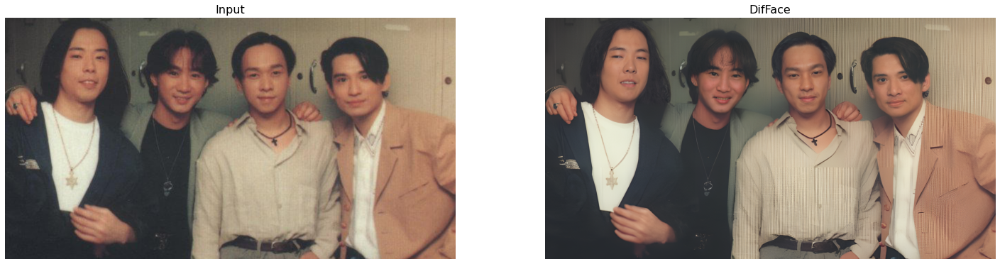

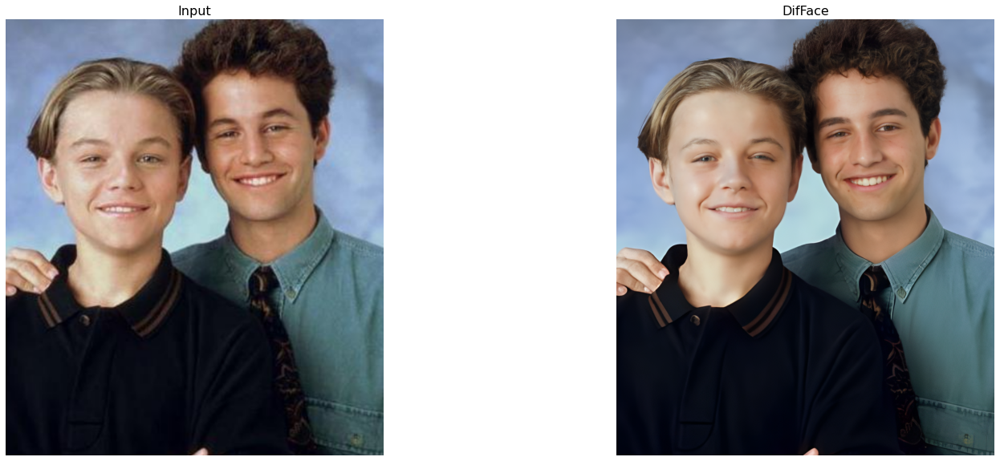

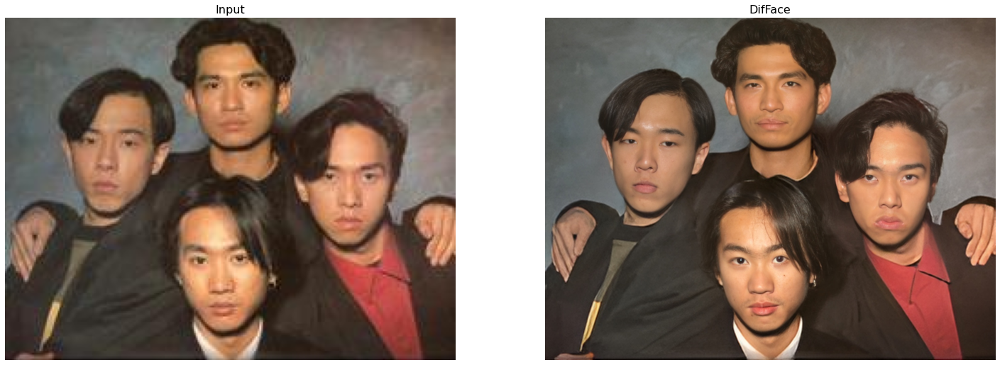

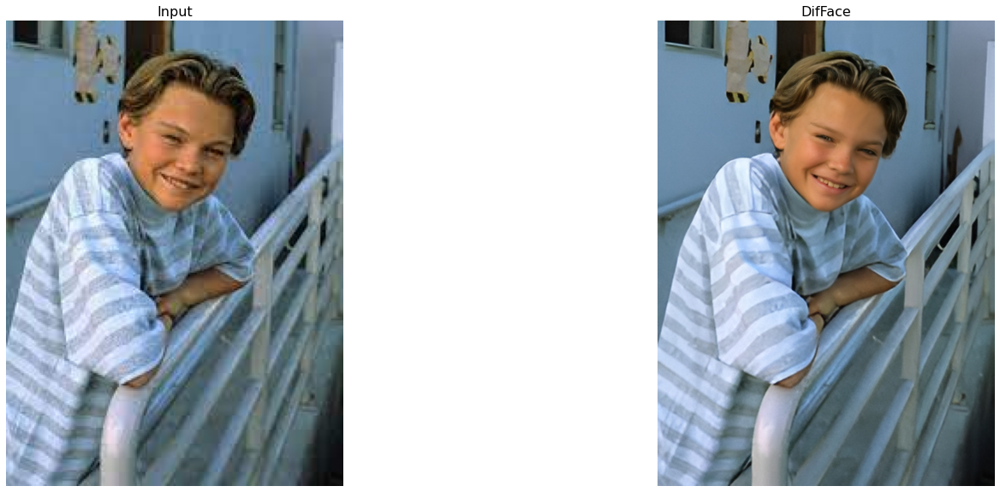

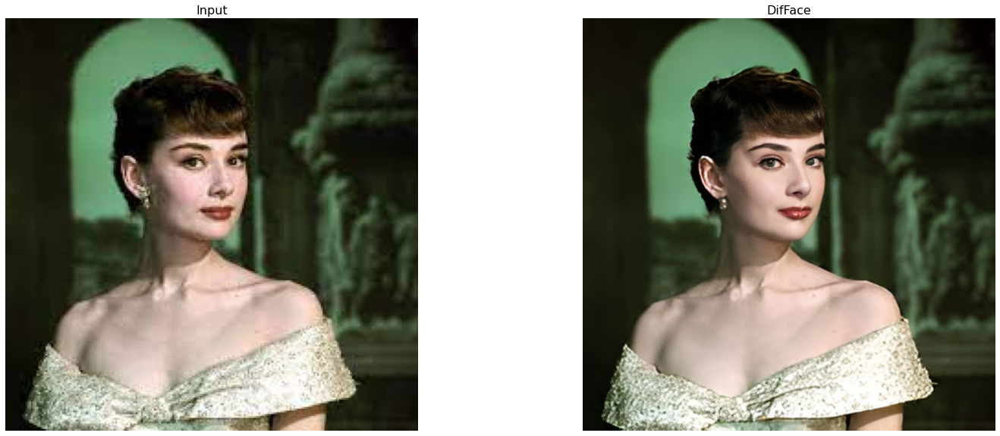

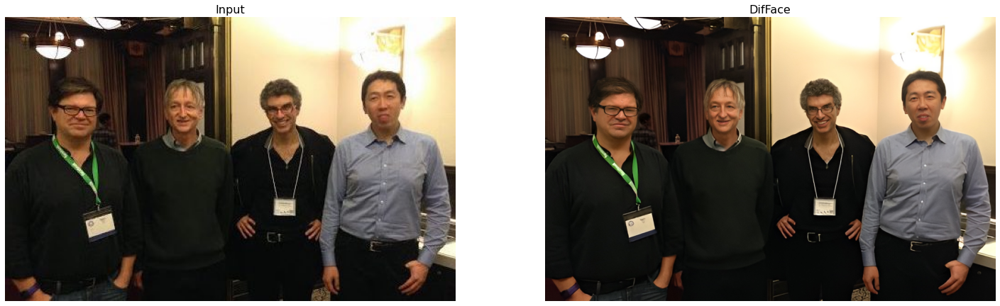

In [9]:
#  顔画像の復元（画像全体）
"""
!python inference_difface.py 
  -t 200   #  事前学習した拡散モデルの全長、初期値250 
  -s 80    # DifFaceの開始時間、初期値100
  --in_path [画像フォルダ/画像パス] 
  --out_path [結果フォルダ] 
  --gpu_id [gpu index]
"""

!python /content/DifFace/inference_difface.py \
  -t 200 -s 80 \
  --in_path /content/DifFace/testdata/whole_imgs/ \
  --out_path /content/result_unaligned \
  --gpu_id 0

in_dir = "/content/DifFace/testdata/whole_imgs"
im_path_list = sorted([x for x in Path(in_dir).glob("*.png")])
im_path_list.extend([x for x in Path(in_dir).glob("*.jpg")])
out_dir = Path("/content/result_unaligned/restored_image")
for im_path_in in im_path_list:
  im1 = imread(str(im_path_in))
  im_path_out = out_dir / im_path_in.name
  im2 = imread(str(im_path_out))
  display(im1, im2)